In [ ]:

import numpy as np # linear algebra
import pandas as pd # data processing



import os
for dirname, _, filenames in os.walk('manufacturing_6G_dataset.csv'):
    for filename in filenames:
        print(os.path.join(dirname, filename))


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score

# Models
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
import xgboost as xgb
import lightgbm as lgb


import plotly.express as px
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D
from wordcloud import WordCloud
from sklearn.ensemble import RandomForestClassifier


In [ ]:
df = pd.read_csv("manufacturing_6G_dataset.csv")

In [ ]:
df.head()

,Timestamp,Machine_ID,Operation_Mode,Temperature_C,Vibration_Hz,Power_Consumption_kW,Network_Latency_ms,Packet_Loss_%,Quality_Control_Defect_Rate_%,Production_Speed_units_per_hr,Predictive_Maintenance_Score,Error_Rate_%,Efficiency_Status
0,2024-01-01 00:00:00,39,Idle,74.137590,3.500595,8.612162,10.650542,0.207764,7.751261,477.657391,0.344650,14.965470,Low
1,2024-01-01 00:01:00,29,Active,84.264558,3.355928,2.268559,29.111810,2.228464,4.989172,398.174747,0.769848,7.678270,Low
2,2024-01-01 00:02:00,15,Active,44.280102,2.079766,6.144105,18.357292,1.639416,0.456816,108.074959,0.987086,8.198391,Low
3,2024-01-01 00:03:00,43,Active,40.568502,0.298238,4.067825,29.153629,1.161021,4.582974,329.579410,0.983390,2.740847,Medium
4,2024-01-01 00:04:00,8,Idle,75.063817,0.345810,6.225737,34.029191,4.796520,2.287716,159.113525,0.573117,12.100686,Low


In [ ]:
df.isnull().sum()

,0
Timestamp,0
Machine_ID,0
Operation_Mode,0
Temperature_C,0
Vibration_Hz,1
Power_Consumption_kW,1
Network_Latency_ms,1
Packet_Loss_%,1
Quality_Control_Defect_Rate_%,1
Production_Speed_units_per_hr,1


In [ ]:
df.duplicated().sum()

np.int64(0)

In [ ]:
df.shape

(51983, 13)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51983 entries, 0 to 51982
Data columns (total 13 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   Timestamp                      51983 non-null  object 
 1   Machine_ID                     51983 non-null  int64  
 2   Operation_Mode                 51983 non-null  object 
 3   Temperature_C                  51983 non-null  float64
 4   Vibration_Hz                   51982 non-null  float64
 5   Power_Consumption_kW           51982 non-null  float64
 6   Network_Latency_ms             51982 non-null  float64
 7   Packet_Loss_%                  51982 non-null  float64
 8   Quality_Control_Defect_Rate_%  51982 non-null  float64
 9   Production_Speed_units_per_hr  51982 non-null  float64
 10  Predictive_Maintenance_Score   51982 non-null  float64
 11  Error_Rate_%                   51982 non-null  float64
 12  Efficiency_Status              51982 non-null 

In [ ]:
df.describe()

,Machine_ID,Temperature_C,Vibration_Hz,Power_Consumption_kW,Network_Latency_ms,Packet_Loss_%,Quality_Control_Defect_Rate_%,Production_Speed_units_per_hr,Predictive_Maintenance_Score,Error_Rate_%
count,51983.000000,51983.000000,51982.000000,51982.000000,51982.000000,51982.000000,51982.000000,51982.000000,51982.000000,51982.000000
mean,25.484331,59.994475,2.549400,5.745396,25.532245,2.488225,5.024380,275.665607,0.499519,7.522897
std,14.392737,17.315671,1.413796,2.456946,14.135080,1.443803,2.883153,129.931800,0.289245,4.328432
min,1.000000,30.000287,0.100011,1.500340,1.000025,0.000026,0.000531,50.005997,0.000020,0.000112
25%,13.000000,44.976893,1.324264,3.629804,13.220006,1.234991,2.540536,162.871015,0.247900,3.782206
50%,25.000000,60.006598,2.551065,5.748353,25.566670,2.486786,5.020095,275.479533,0.500850,7.539868
75%,38.000000,74.911817,3.776251,7.873368,37.832290,3.735173,7.525650,388.545993,0.749975,11.283737
max,50.000000,89.998979,4.999643,9.999864,49.999917,4.999947,9.999301,499.996768,0.999948,14.999869


In [ ]:
df.columns

Index(['Timestamp', 'Machine_ID', 'Operation_Mode', 'Temperature_C',
       'Vibration_Hz', 'Power_Consumption_kW', 'Network_Latency_ms',
       'Packet_Loss_%', 'Quality_Control_Defect_Rate_%',
       'Production_Speed_units_per_hr', 'Predictive_Maintenance_Score',
       'Error_Rate_%', 'Efficiency_Status'],
      dtype='object')

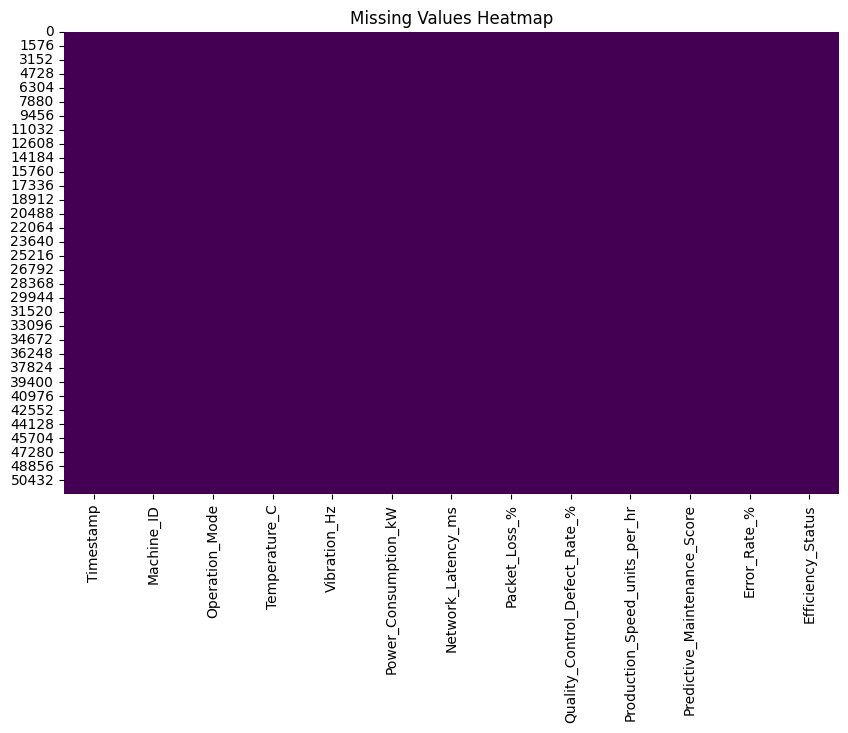

In [ ]:
plt.figure(figsize=(10,6))
sns.heatmap(df.isnull(), cmap='viridis', cbar=False)
plt.title("Missing Values Heatmap")
plt.show()


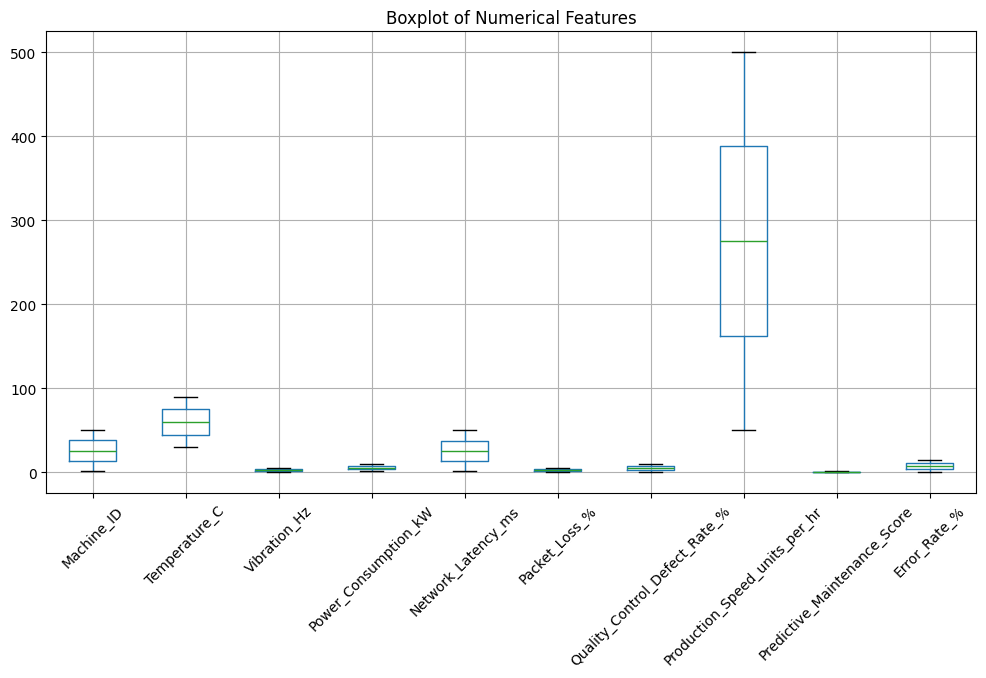

In [ ]:
df.boxplot(figsize=(12,6))
plt.xticks(rotation=45)
plt.title("Boxplot of Numerical Features")
plt.show()


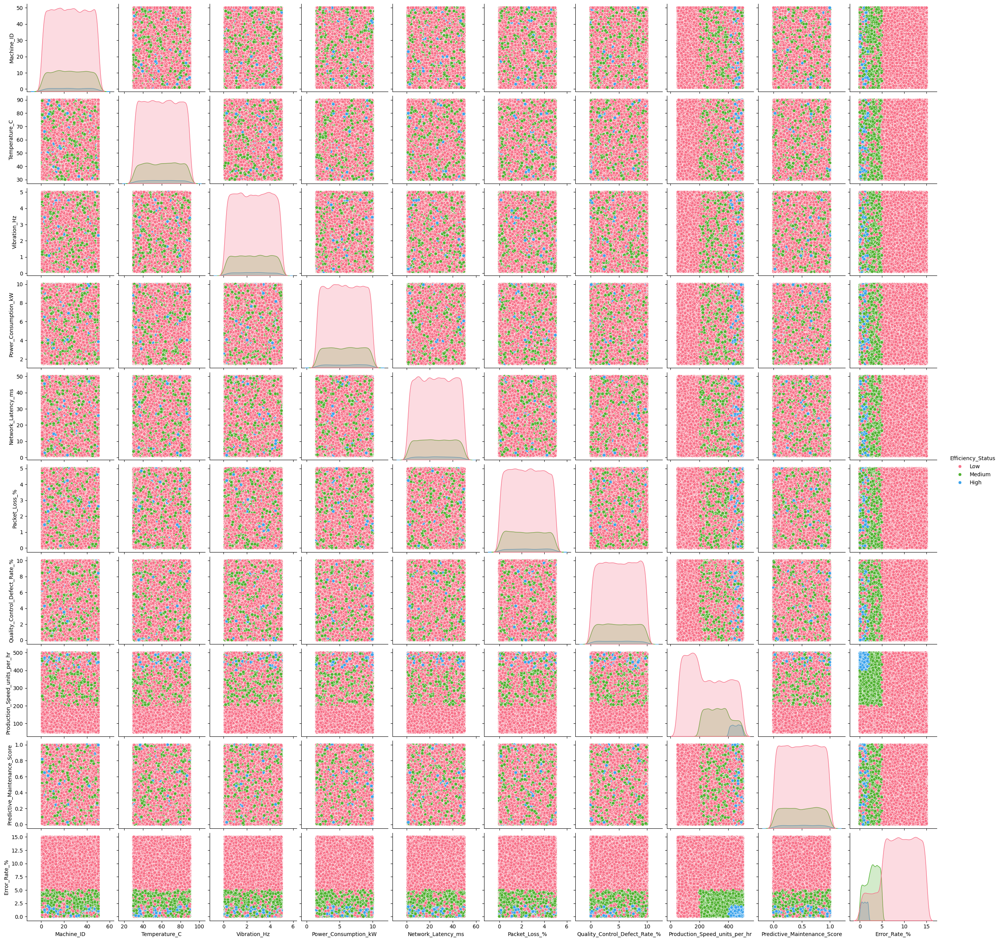

In [ ]:
sns.pairplot(df, hue="Efficiency_Status", palette="husl")
plt.show()


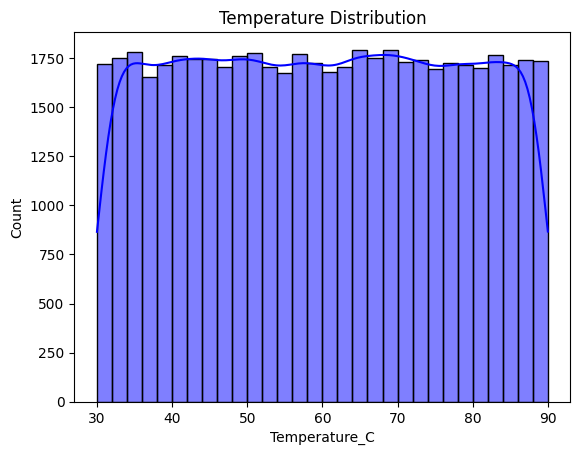

In [ ]:
sns.histplot(df["Temperature_C"], bins=30, kde=True, color="blue")
plt.title("Temperature Distribution")
plt.show()


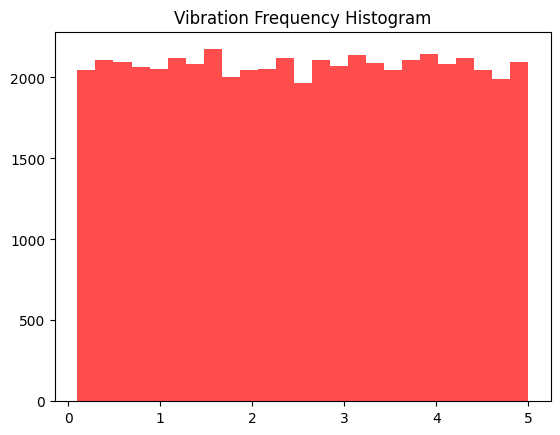

In [ ]:
plt.hist(df["Vibration_Hz"], bins=25, color='red', alpha=0.7)
plt.title("Vibration Frequency Histogram")
plt.show()


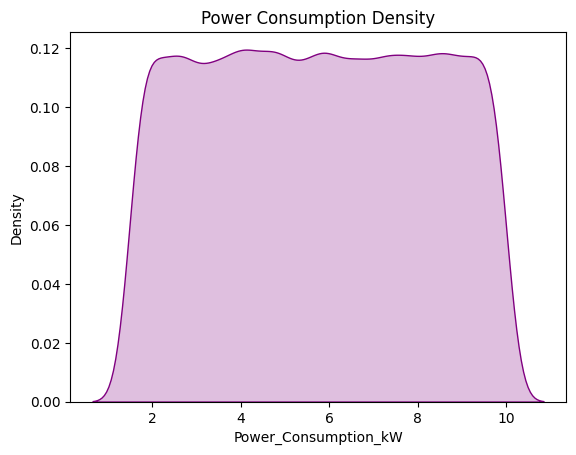

In [ ]:
sns.kdeplot(df["Power_Consumption_kW"], shade=True, color="purple")
plt.title("Power Consumption Density")
plt.show()


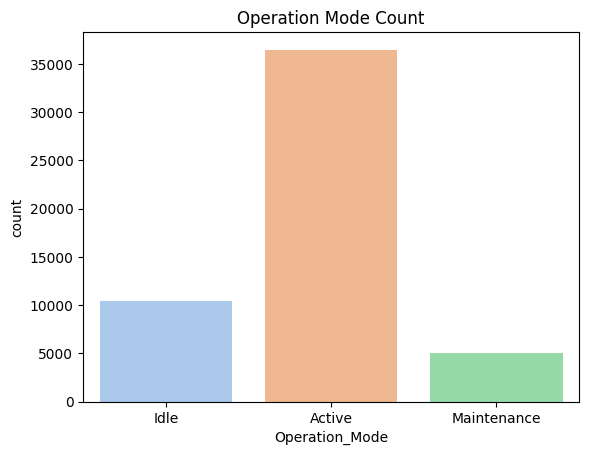

In [ ]:
sns.countplot(x=df["Operation_Mode"], palette="pastel")
plt.title("Operation Mode Count")
plt.show()


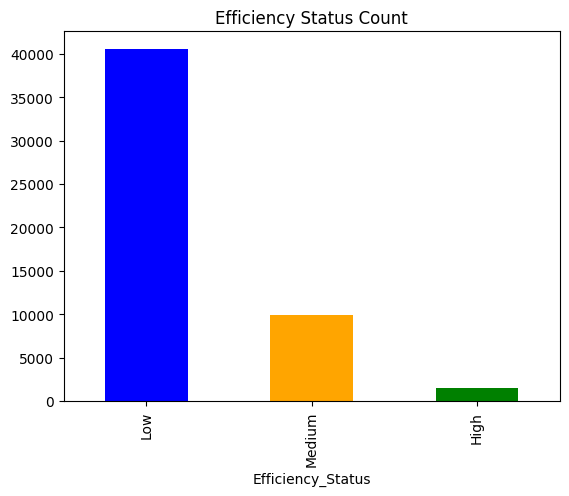

In [ ]:
df["Efficiency_Status"].value_counts().plot(kind="bar", color=["blue", "orange", "green"])
plt.title("Efficiency Status Count")
plt.show()


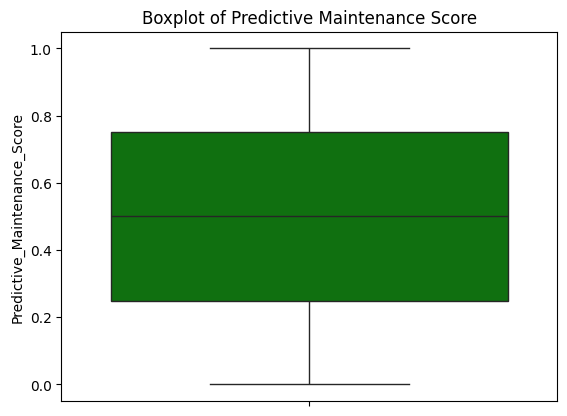

In [ ]:
sns.boxplot(y=df["Predictive_Maintenance_Score"], color="green")
plt.title("Boxplot of Predictive Maintenance Score")
plt.show()


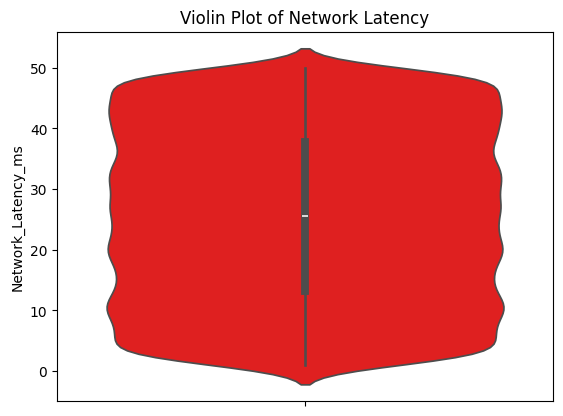

In [ ]:
sns.violinplot(y=df["Network_Latency_ms"], color="red")
plt.title("Violin Plot of Network Latency")
plt.show()


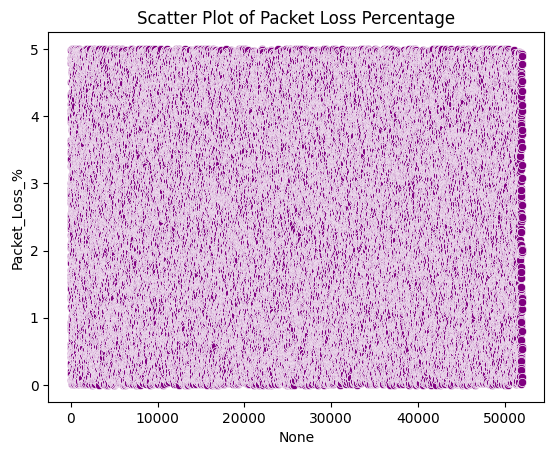

In [ ]:
sns.scatterplot(x=df.index, y=df["Packet_Loss_%"], color="purple")
plt.title("Scatter Plot of Packet Loss Percentage")
plt.show()


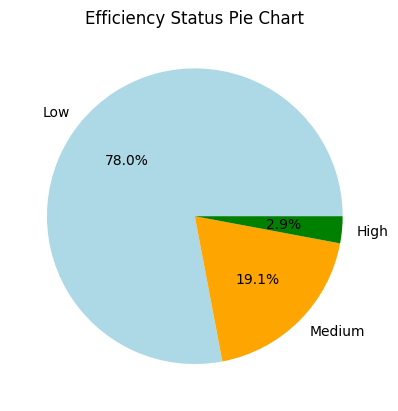

In [ ]:
df["Efficiency_Status"].value_counts().plot.pie(autopct="%1.1f%%", colors=["lightblue", "orange", "green"])
plt.title("Efficiency Status Pie Chart")
plt.ylabel("")
plt.show()


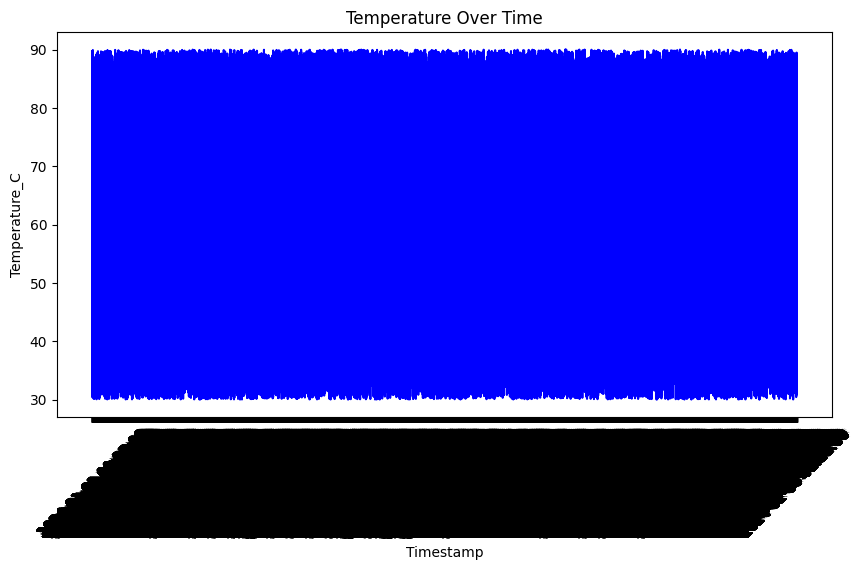

In [ ]:
plt.figure(figsize=(10,5))
sns.lineplot(x=df["Timestamp"], y=df["Temperature_C"], color="blue")
plt.xticks(rotation=45)
plt.title("Temperature Over Time")
plt.show()


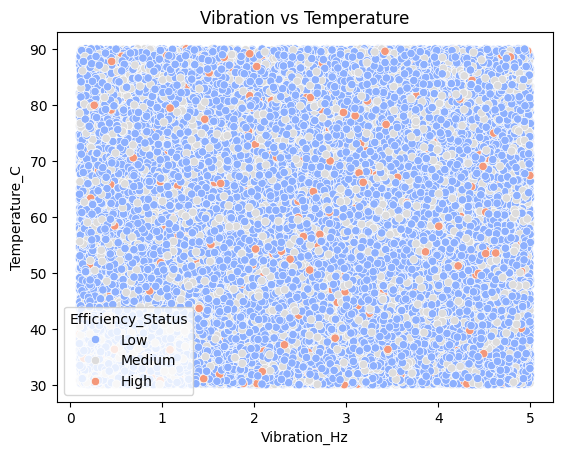

In [ ]:
sns.scatterplot(x=df["Vibration_Hz"], y=df["Temperature_C"], hue=df["Efficiency_Status"], palette="coolwarm")
plt.title("Vibration vs Temperature")
plt.show()


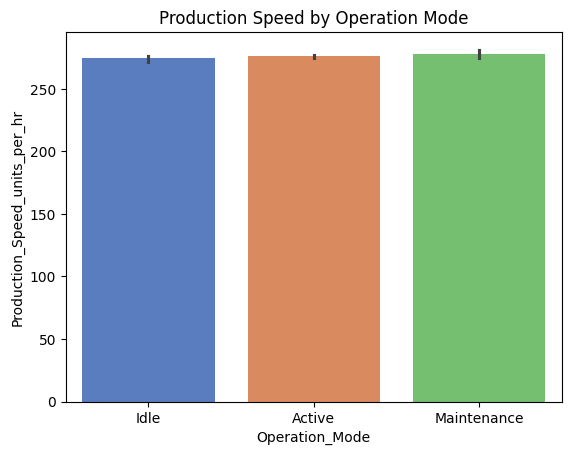

In [ ]:
sns.barplot(x="Operation_Mode", y="Production_Speed_units_per_hr", data=df, palette="muted")
plt.title("Production Speed by Operation Mode")
plt.show()


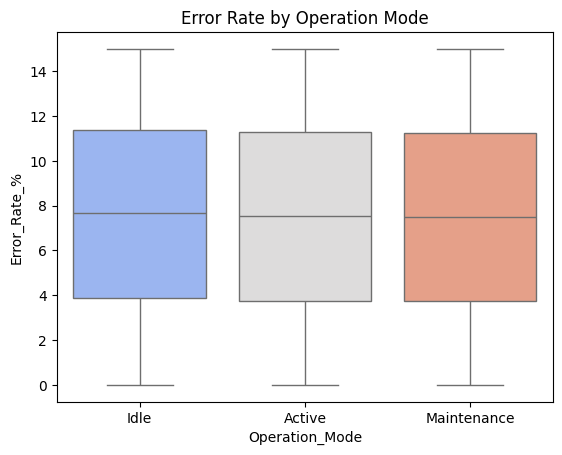

In [ ]:
sns.boxplot(x="Operation_Mode", y="Error_Rate_%", data=df, palette="coolwarm")
plt.title("Error Rate by Operation Mode")
plt.show()


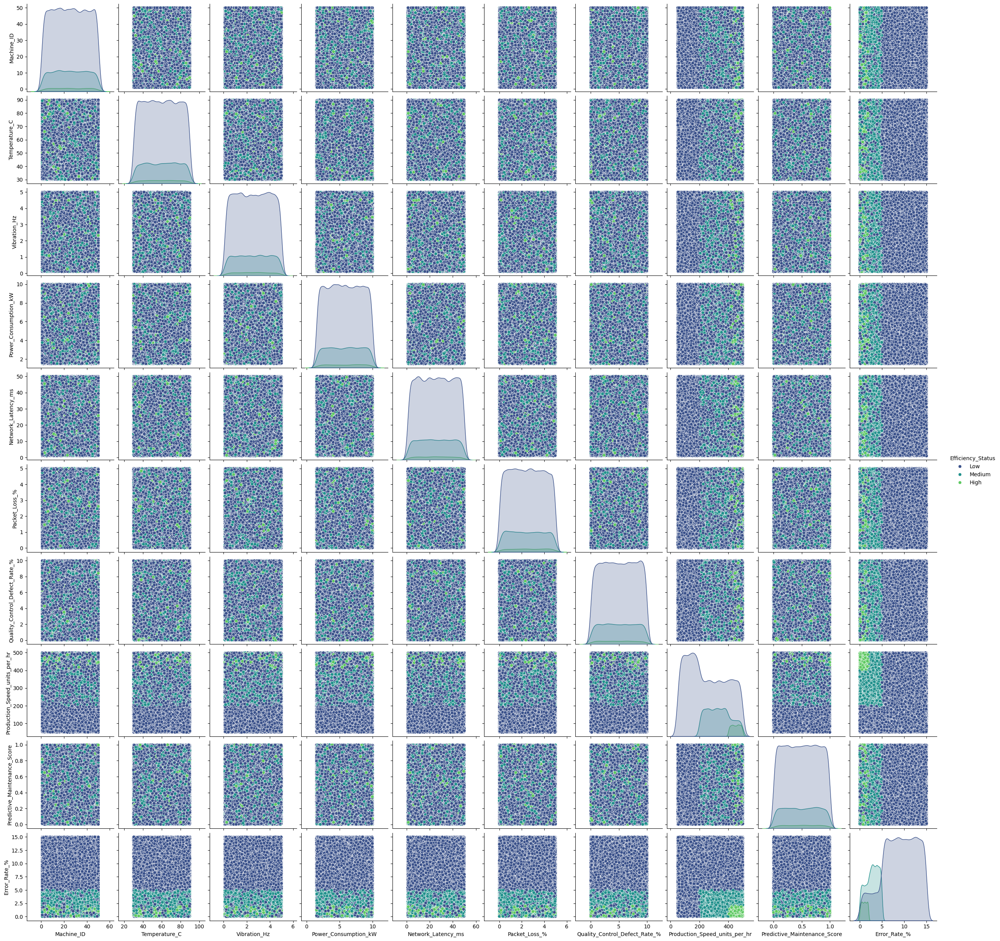

In [ ]:
sns.pairplot(df, hue="Efficiency_Status", diag_kind="kde", palette="viridis")
plt.show()


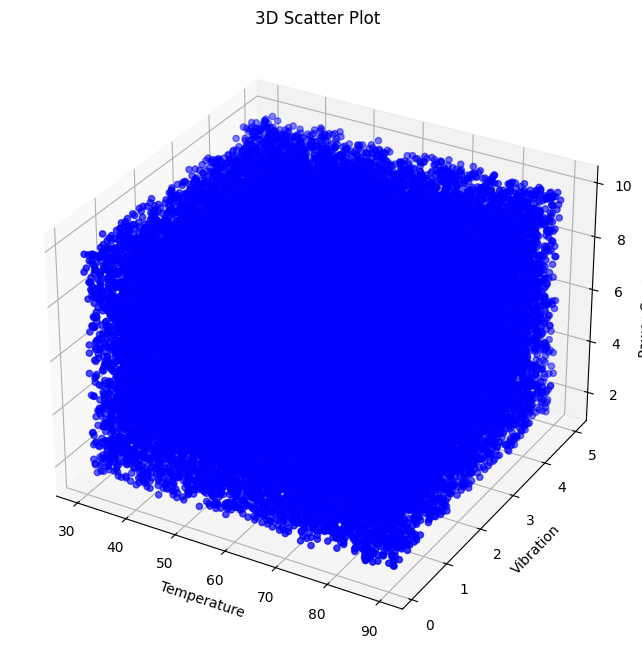

In [ ]:
fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection="3d")
ax.scatter(df["Temperature_C"], df["Vibration_Hz"], df["Power_Consumption_kW"], c="blue", marker="o")
ax.set_xlabel("Temperature")
ax.set_ylabel("Vibration")
ax.set_zlabel("Power Consumption")
plt.title("3D Scatter Plot")
plt.show()


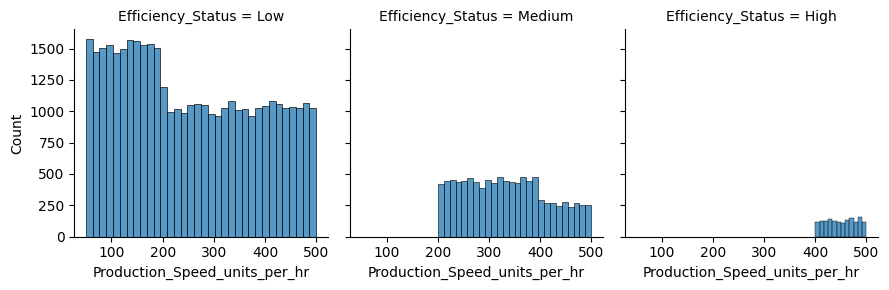

In [ ]:
g = sns.FacetGrid(df, col="Efficiency_Status")
g.map(sns.histplot, "Production_Speed_units_per_hr")
plt.show()


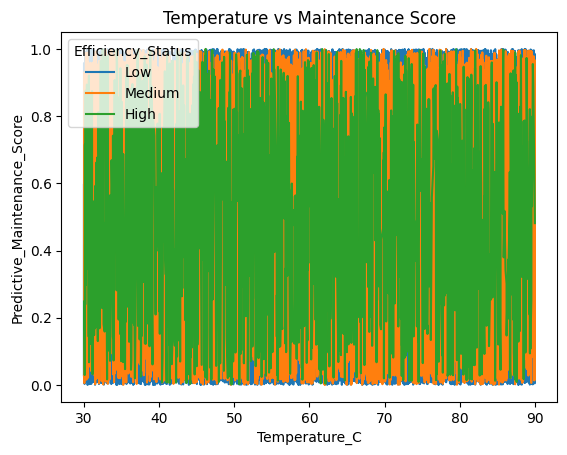

In [ ]:
sns.lineplot(x=df["Temperature_C"], y=df["Predictive_Maintenance_Score"], hue=df["Efficiency_Status"])
plt.title("Temperature vs Maintenance Score")
plt.show()


In [ ]:
fig = px.sunburst(df, path=["Operation_Mode", "Efficiency_Status"], values="Production_Speed_units_per_hr")
fig.show()


In [ ]:
fig = px.treemap(df, path=["Machine_ID", "Efficiency_Status"], values="Power_Consumption_kW")
fig.show()


In [ ]:
!pip install catboost


In [ ]:
!pip install numpy --upgrade --force-reinstall


  Using cached numpy-2.2.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (62 kB)
Using cached numpy-2.2.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (16.4 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
catboost 1.2.7 requires numpy<2.0,>=1.16.0, but you have numpy 2.2.4 which is incompatible.
tensorflow 2.18.0 requires numpy<2.1.0,>=1.26.0, but you have numpy 2.2.4 which is incompatible.
numba 0.60.0 requires numpy<2.1,>=1.22, but you have numpy 2.2.4 which is incompatible.


In [ ]:
!pip install numpy==1.26.4 --force-reinstall


  Using cached numpy-1.26.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (61 kB)
Using cached numpy-1.26.4-cp311-cp311-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (18.3 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.26.4 which is incompatible.


In [ ]:
!pip uninstall catboost -y
!pip install catboost

Found existing installation: catboost 1.2.7
Uninstalling catboost-1.2.7:
  Successfully uninstalled catboost-1.2.7
  Using cached catboost-1.2.7-cp311-cp311-manylinux2014_x86_64.whl.metadata (1.2 kB)
Using cached catboost-1.2.7-cp311-cp311-manylinux2014_x86_64.whl (98.7 MB)


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import xgboost as xgb
import lightgbm as lgb
import catboost as cb
import warnings
warnings.filterwarnings("ignore")


In [ ]:
# ✅ STEP 1: Load the dataset first
df = pd.read_csv("manufacturing_6G_dataset.csv")

In [ ]:
le = LabelEncoder()
for col in df.select_dtypes(include=['object']).columns:
    df[col] = le.fit_transform(df[col])


In [ ]:
X = df.drop("Efficiency_Status", axis=1)  # Independent Variables
y = df["Efficiency_Status"]                # Target Variable


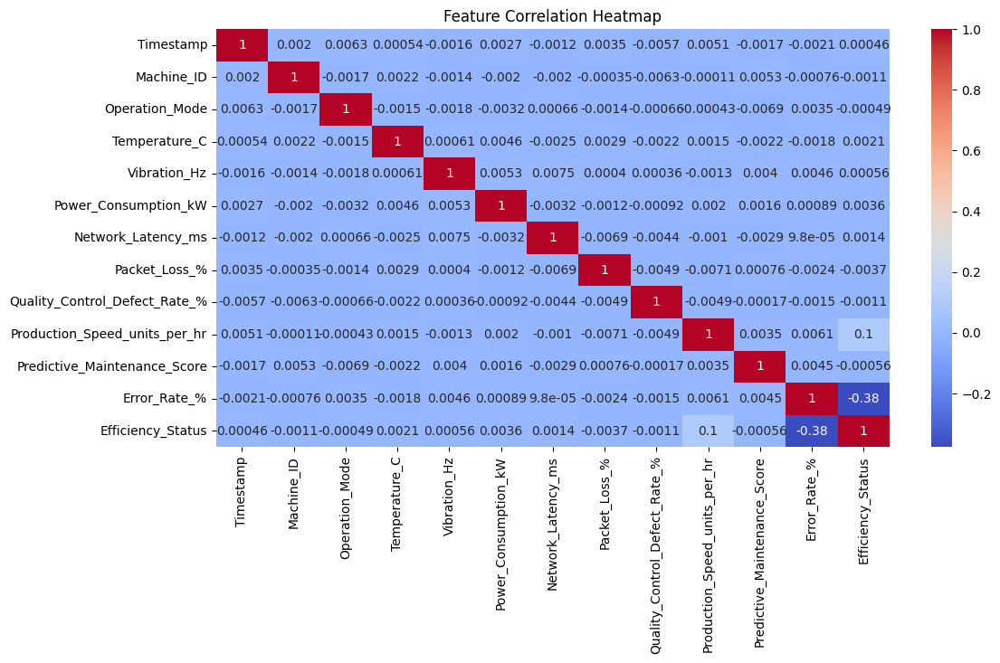

In [ ]:
plt.figure(figsize=(12,6))
sns.heatmap(df.corr(), annot=True, cmap="coolwarm")
plt.title("Feature Correlation Heatmap")
plt.show()


In [ ]:
from sklearn.feature_selection import SelectFromModel

rf = RandomForestClassifier(n_estimators=100)
rf.fit(X, y)
sfm = SelectFromModel(rf, threshold=0.01)
X_selected = sfm.transform(X)


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)


In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)


In [ ]:
models = {
    "Logistic Regression": LogisticRegression(),
    "K-Nearest Neighbors": KNeighborsClassifier(),
    "Support Vector Machine": SVC(),
    "Decision Tree": DecisionTreeClassifier(),
    "Random Forest": RandomForestClassifier(),
    "Gradient Boosting": GradientBoostingClassifier(),
    "Naive Bayes": GaussianNB(),
    "XGBoost": xgb.XGBClassifier(),
    "LightGBM": lgb.LGBMClassifier(),
    "CatBoost": cb.CatBoostClassifier(verbose=0)
}


In [ ]:
results = {}

for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    results[name] = accuracy
    print(f"{name}: {accuracy:.4f}")
    print(classification_report(y_test, y_pred))


Logistic Regression: 0.9166
              precision    recall  f1-score   support

           0       0.89      0.85      0.87       625
           1       0.95      0.96      0.95     15464
           2       0.80      0.77      0.78      3911

    accuracy                           0.92     20000
   macro avg       0.88      0.86      0.87     20000
weighted avg       0.92      0.92      0.92     20000

K-Nearest Neighbors: 0.9986
              precision    recall  f1-score   support

           0       0.99      1.00      0.99       625
           1       1.00      1.00      1.00     15464
           2       1.00      0.99      1.00      3911

    accuracy                           1.00     20000
   macro avg       1.00      1.00      1.00     20000
weighted avg       1.00      1.00      1.00     20000

Support Vector Machine: 0.9936
              precision    recall  f1-score   support

           0       0.96      0.96      0.96       625
           1       1.00      1.00      1.0

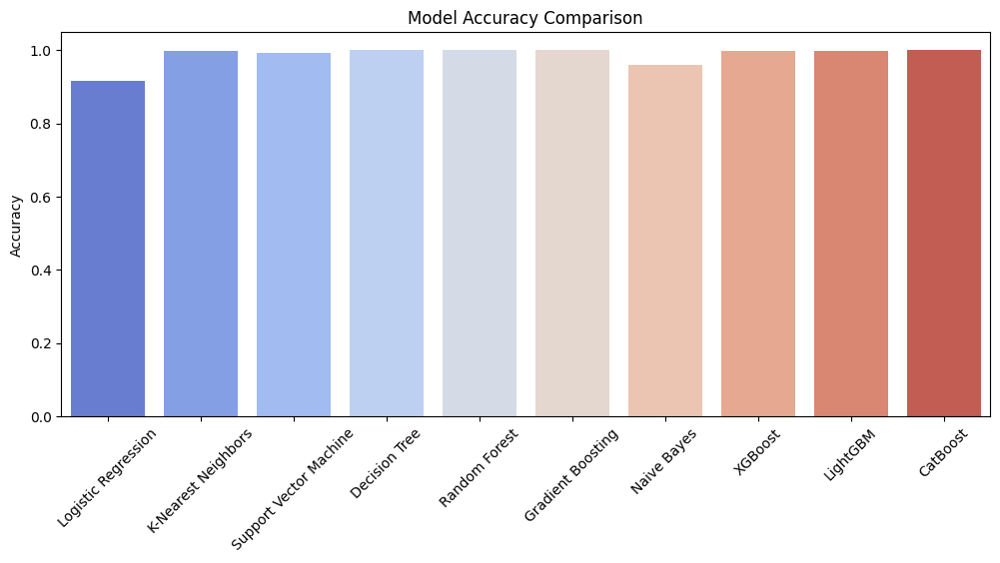

In [ ]:
plt.figure(figsize=(12,5))
sns.barplot(x=list(results.keys()), y=list(results.values()), palette="coolwarm")
plt.xticks(rotation=45)
plt.ylabel("Accuracy")
plt.title("Model Accuracy Comparison")
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, roc_curve, auc, precision_recall_curve

# Function to plot confusion matrix
def plot_confusion_matrix(y_true, y_pred, model_name):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title(f'Confusion Matrix - {model_name}')
    plt.show()


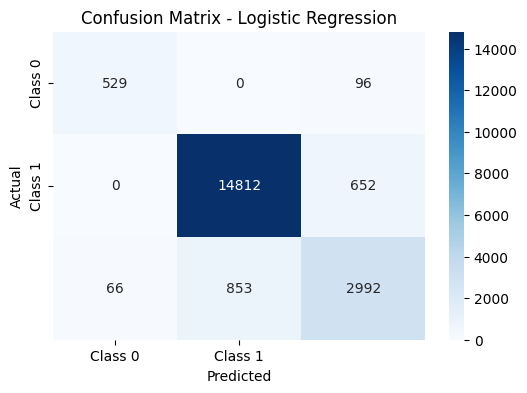

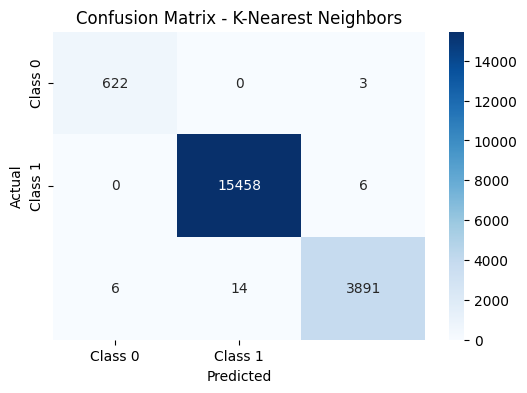

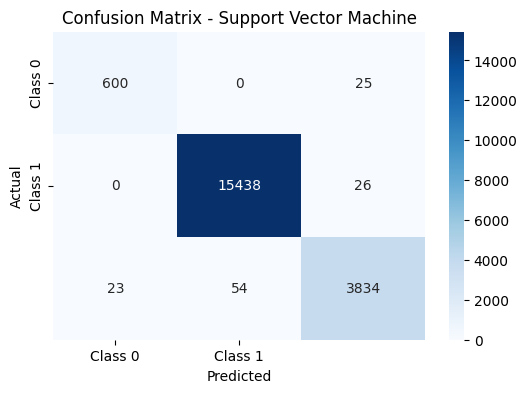

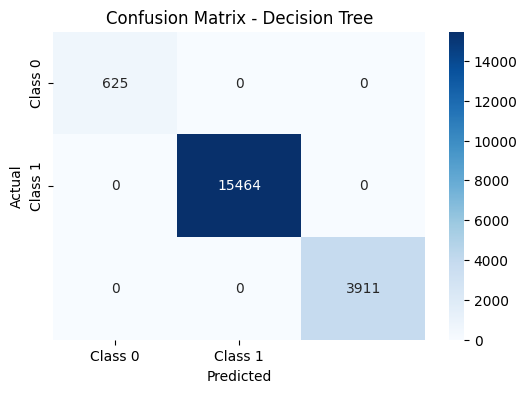

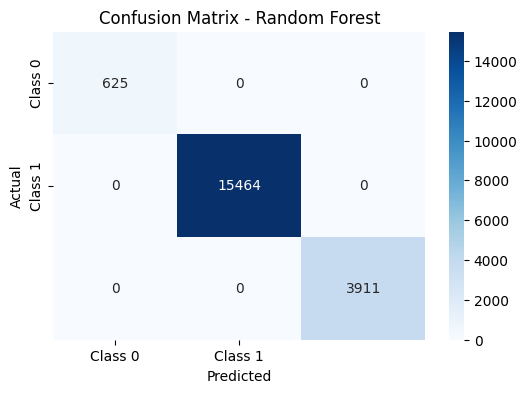

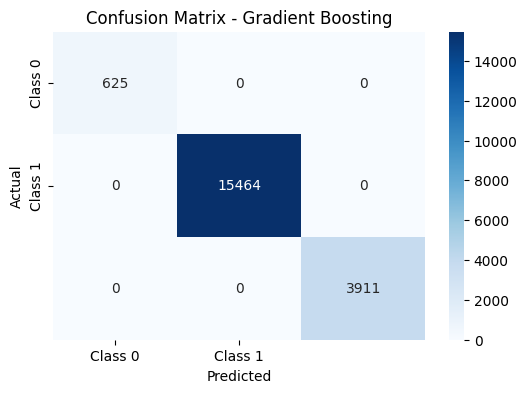

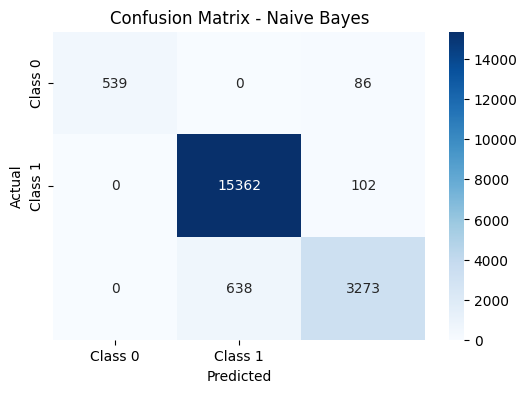

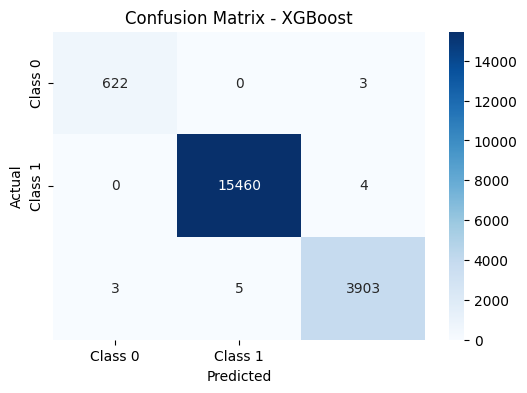

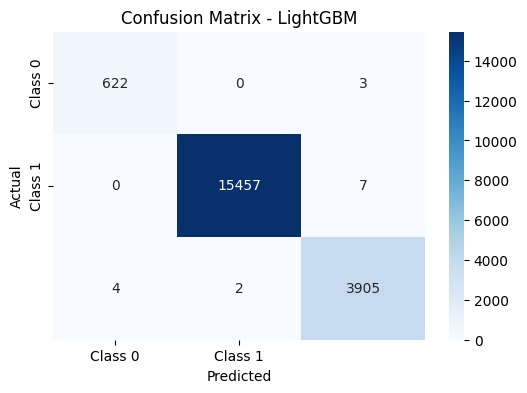

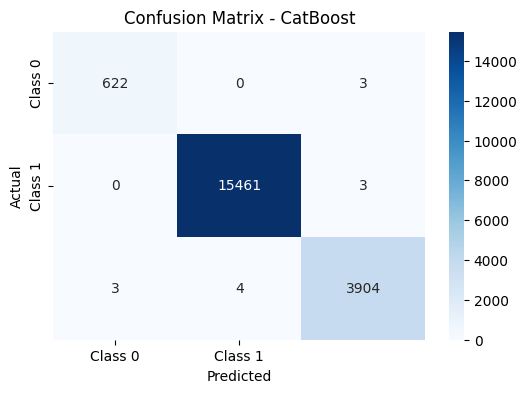

In [ ]:
for name, model in models.items():
    y_pred = model.predict(X_test)
    plot_confusion_matrix(y_test, y_pred, name)
